# Imports

In [1]:
### Basic Libraries
# from datetime import datetime
# !pip install numpy
import numpy as np
# !pip install pandas
import pandas as pd

### Visualization
# !pip install matplotlib
import matplotlib.pyplot as plt
# !pip install seaborn
# import seaborn as sns
# !pip install plotly
import plotly.express as px
# !pip install squarify
# import squarify
from pylab import rcParams
rcParams['figure.figsize'] = 20, 10
# !pip install nbformat>=4.2.0

### Sklearn
# !pip install scikit-learn
# from sklearn.preprocessing import StandardScaler
# from sklearn.impute import KNNImputer
# from sklearn.model_selection import train_test_split
# from sklearn.cluster import KMeans
# from sklearn.metrics import silhouette_score

### Functions
from utils1 import (
    plot_pie_chart, 
    plot_bar_chart, 
    plot_line_chart, 
    plot_histogram, 
    plot_correlation_matrix, 
    plot_scatter, 
    knn_imputer_best_k
)

### Warnings
import warnings
warnings.filterwarnings('ignore')

# Set the path to the data files
# path = "C:\\Users\\ritaf\\Documentos\\Estudos\\NovaIMS\\Mestrado_GIBI\\DM_I\\DM_Project\\"

# Autoreload
# %load_ext autoreload
# %autoreload 2



# Data

In [2]:
data = pd.read_excel('Data\project_data.xlsx')

In [3]:
data.head()

,ID_Client,Frequency_items,Potencial_Score,ZIP_Code,Longevity_months,Latitude,Longitude,Credit_factor,Relevance_criteria,Store_state,...,Meat,Dairy,Fresh_Foods,Frozen_Foods,Fruit_Beverages,Pastry,Sodas,Toiletries,Veggies,Wines
0,10156431SEG17NKID781,38,-0.400000,0,23,0.000000,-1.666667,0.7,Priority,NSW,...,59,"88,000",148,150.0,105,27,24,27.0,10,0
1,9056576FIA11NKID679,50,-0.300000,0,24,0.200000,0.000000,0.7,Priority,NSW,...,7,"90,000",134,26.0,20,31,-12,2.0,18,2
2,9253304IST6NKID248,48,1.600000,0,32,0.428571,1.000000,0.7,Priority,NSW,...,0,"89,000",39,-6.0,25,32,17,33.0,26,-13
3,9661067PER12NKID393,46,-0.900000,0,-4,-0.400000,-0.500000,4.5,Priority,NSW,...,0,"89,000",26,66.0,16,29,31,28.0,-2,8
4,9956825FEG11NKID326,31,31.607792,8,10,1.000000,0.714286,0.7,Priority,NSW,...,0,"90,000",-2,57.0,27,45,46,19.0,23,9


# Data Corrections

Corrections to be made:
- ID_Client: has nans, ' ', duplicates (com dados das colunas diferentes)
- Frequency_items: no nan, no outliers, no problem with negs, slight skew
- Potencial_Score: no nan, big outliers, has neg values, can be rounded (too many decimal cases)
- ZIP_Code: has nans, has '  ', missing the 3, distribuição muito skewed, is object and should be int
- Longevity_months: no nans, no outliers, has neg values, good sistribution
- Latitude & Longitude: no nans, made up values in africa (middle of ocean and in strainght lines -> lat e long between -5 and 5)
- Credit_factor: no nans, has outliers, no negs
- Relevance_criteria: no nans, but unknowns as string, very big majority group
- Recency_in_weeks: no nans, has negs, not really outliers, but kinda skewed (ok)
- Returns: no nana, has negs, has big outliers, very many of 0s (ok)
- Gender: has nans, has white spaces, has weird values, has ambiguity (female, Female)
- Flaged: no nans, majority of 0s (ok), has 2s (no sense since boolean)
- Promotional_percentage: no nans, has negs, majority of 0s (ok), has outliers
- Education: has nans, has white spaces, 'degree' is ambiguous, 'High School' and 'High School ' (with ws)
- Beer: no nans, no negs, has outliers
- Bottled_Water: no nans, no negs, has outliers
- Dairy: no nans, no negs, has outliers, is object and should be number
- Fresh_Foods: no nans, has negs, has outliers
- Frozen_Foods: has nans, has negs, has outliers
- Fruit_Beverages: no nans, has negs, has outliers
- Pastry: no nans, no negs, has outliers
- Sodas: no nans, has negs, has outliers
- Toiletries: no nans, has negs, has outliers
- Veggies: no nans, has negs, has outliers
- Wines: no nans, has negs, has outliers
- ID_Store_last, Checked_ok and Store_state are constant




Coisas para ver:
- frequency items de 1 com + que 1 categoria de produtos (acho que há 1... muito errado)
- plot de freq items com amounts spent (outliers)
-ver percentagem de erros que estão em africa


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 123683 entries, 0 to 123682
Data columns (total 31 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   ID_Client               123354 non-null  object 
 1   Frequency_items         123683 non-null  int64  
 2   Potencial_Score         123683 non-null  float64
 3   ZIP_Code                123089 non-null  object 
 4   Longevity_months        123683 non-null  int64  
 5   Latitude                123683 non-null  float64
 6   Longitude               123683 non-null  float64
 7   Credit_factor           123683 non-null  float64
 8   Relevance_criteria      123683 non-null  object 
 9   Store_state             123683 non-null  object 
 10  Recency_in_weeks        123683 non-null  int64  
 11  Returns                 123683 non-null  int64  
 12  ID_Store_last           123683 non-null  int64  
 13  Gender                  42566 non-null   object 
 14  Flaged              

In [5]:
# Drop constant columns
data.drop(columns=['ID_Store_last', 'Checked_ok', 'Store_state'], inplace=True)

# Setting up missing values as NaN
data['ID_Client'].replace(' ', np.nan, inplace=True)

# Round Potencial_Score to 2 decimal places (OPTIONAL)
data['Potencial_Score'] = data['Potencial_Score'].round(2)


# OPTION 1: DROP THE WHOLE COLUMN... IT IS ZERO REPRESENTATIVE OF GEOGRAPHICAL LOCATION
# data.drop(columns=['ZIP_Code'], inplace=True)

# OPTION 2: REPLACE EMPTY VALUES WITH NaN AND USE KNN IMPUTER
data['ZIP_Code'].replace('  ', np.nan, inplace=True) # 1% of NaN

# OPTION 3: REPLACE EMPTY VALUES WITH '3' AND USE KNN IMPUTER IN NaN VALUES


# Setting up missing values as NaN
data['Relevance_criteria'].replace('Unknown', np.nan, inplace=True) # 1,7% of NaN

# Correcting values and setting up missing values as NaN
data['Gender'].replace({'Female': 'female', '    ': np.nan, 'm': np.nan, 'mm': np.nan, 'j': np.nan}, inplace=True) # 73% of NaN
# Vast majority becomes NaN (~73% is NaN) -> Drop column
# data.drop(columns=['Gender'], inplace=True)

# Correcting values - VAI SER PRECISO CORRIGIR DATATYPES DEPOIS DE IMPUTAR (FICOU FLOAT POR CAUSSA DE NAN)
data['Flaged'].replace(2, np.nan, inplace=True) # ~0% of NaN

# Correcting values and setting up missing values as NaN
data['Education'].replace({'High School ': 'High School', ' ': np.nan, 'Bachelor Degree': 'BSc Degree'}, inplace=True) # 42% of NaN

# Convert Dairy to the appropriate data type
dairy_values = data['Dairy'].str.split(',', expand=True)
dairy_values[1] = dairy_values[1].astype(float)
if (dairy_values[1] != 0).any():
    data['Dairy'] = data['Dairy'].str.replace(',', '.').astype(float)
else:
    data['Dairy'] = data['Dairy'].str.replace(',000', '').astype(int)

# Correcting Data Types - VAI SER PRECISO CORRIGIR DATATYPES DEPOIS DE IMPUTAR (FICOU FLOAT POR CAUSSA DE NAN)
# if ((data['Frozen_Foods'].dropna() % 1 == 0).all()):
#     data['Frozen_Foods'] = data['Frozen_Foods'].fillna(1000).astype(int)
#     data['Frozen_Foods'] = data['Frozen_Foods'].replace(1000, np.nan) # 0,5% of NaN

# Correcting Data Types
if ((data['Toiletries'].dropna() % 1 == 0).all()):
    data['Toiletries'] = data['Toiletries'].fillna(1000).astype(int)
    data['Toiletries'] = data['Toiletries'].replace(1000, np.nan) # no missing values


In [6]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Frequency_items,123683.0,38.261224,13.594001,1.0,29.000000,37.00,47.000000,131.000000
Potencial_Score,123683.0,30.392314,99.673570,-1.0,0.800000,24.06,39.700000,11481.040000
Longevity_months,123683.0,13.665354,9.881178,-12.0,6.000000,13.00,21.000000,45.000000
Latitude,123683.0,25.249363,29.997630,-5.0,-0.166667,1.00,60.126211,72.170287
Longitude,123683.0,6.158188,7.697199,-5.0,-0.166667,1.00,13.971501,30.973885
Credit_factor,123683.0,0.899913,0.799920,0.0,0.700000,0.70,1.000000,28.400000
Recency_in_weeks,123683.0,11.244706,3.799946,-4.0,9.000000,11.00,14.000000,18.000000
Returns,123683.0,4.310972,27.629597,-87.0,0.000000,0.00,0.000000,591.000000
Flaged,123679.0,0.010309,0.101009,0.0,0.000000,0.00,0.000000,1.000000
Promotional_percentage,123683.0,13.940888,54.416311,-2140.0,0.000000,8.00,16.000000,4920.000000


In [7]:
data_g = data.drop(columns=['Gender'])
data_e = data.drop(columns=['Education'])
data_g_e = data.drop(columns=['Gender', 'Education'])
data_z = data.drop(columns=['ZIP_Code'])
data_z_g_e = data_g_e.drop(columns=['ZIP_Code'])

data_mv = data.dropna()
data_g_mv = data_g.dropna()
data_e_mv = data_e.dropna()
data_g_e_mv = data_g_e.dropna()
data_z_mv = data_z.dropna()
data_z_g_e_mv = data_z_g_e.dropna()

percentage_mv_data = 100 - (data_mv.shape[0] / 123683 * 100)
percentage_mv_data_g = 100 - (data_g_mv.shape[0] / 123683 * 100)
percentage_mv_data_e = 100 - (data_e_mv.shape[0] / 123683 * 100)
percentage_mv_data_g_e = 100 - (data_g_e_mv.shape[0] / 123683 * 100)
percentage_mv_data_z = 100 - (data_z_mv.shape[0] / 123683 * 100)
percentage_mv_data_z_g_e = 100 - (data_z_g_e_mv.shape[0] / 123683 * 100)

print(f"Percentage of missing values in the original data: {percentage_mv_data:.2f}%")
print(f"Percentage of missing values in data without gender column: {percentage_mv_data_g:.2f}%")
print(f"Percentage of missing values in data without education column: {percentage_mv_data_e:.2f}%")
print(f"Percentage of missing values in data without gender and education columns: {percentage_mv_data_g_e:.2f}%")
print(f"Percentage of missing values in data without ZIP Code column: {percentage_mv_data_z:.2f}%")
print(f"Percentage of missing values in data without ZIP Code, gender and education columns: {percentage_mv_data_z_g_e:.2f}%")

Percentage of missing values in the original data: 84.55%
Percentage of missing values in data without gender column: 43.19%
Percentage of missing values in data without education column: 73.83%
Percentage of missing values in data without gender and education columns: 3.66%
Percentage of missing values in data without ZIP Code column: 84.39%
Percentage of missing values in data without ZIP Code, gender and education columns: 2.66%


Podemos apagar só a educatio e o gender. Apagar o zip não faz muita diferença e pode ser que seja útil. 

In [8]:
# Drop columns with more than 40% of missing values
data.drop(columns=['Gender', 'Education'], inplace=True)

# Drop ZIP Code column as it has no geographical relevance
# data.drop(columns=['ZIP_Code'], inplace=True)

# Negative Values

### Africa vs Europa

In [9]:
africa = data[data['Latitude'] < 30] #72264
europe = data[data['Latitude'] > 30] #51419

In [11]:
# Select numeric columns excluding 'Latitude' and 'Longitude'
numeric_columns = data.select_dtypes(include=[np.number]).columns.difference(['Latitude', 'Longitude'])

# Filter rows with negative values in any of the numeric columns
negative_values_rows_all = data[numeric_columns].lt(0).any(axis=1)
negative_values_rows_eu = europe[numeric_columns].lt(0).any(axis=1)
negative_values_rows_af = africa[numeric_columns].lt(0).any(axis=1)

# Count the number of such rows
negative_values_count_all = negative_values_rows_all.sum()
negative_values_count_eu = negative_values_rows_eu.sum()
negative_values_count_af = negative_values_rows_af.sum()

print(f"Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude): {negative_values_count_all/data.shape[0]*100:.2f}%")
print(f"Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude) - EUROPE: {negative_values_count_eu/europe.shape[0]*100:.2f}%")
print(f"Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude) - AFRICA: {negative_values_count_af/africa.shape[0]*100:.2f}%")

Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude): 50.92%
Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude) - EUROPE: 41.69%
Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude) - AFRICA: 57.48%


In [ ]:
# DESCOBRIR A PERCENTAGEM DE VALORES NEGATIVOS EM CADA COLUNA

# Create a DataFrame to store the results
negative_percentage_df = pd.DataFrame()

# Add the negative percentage data for each dataset
negative_percentage_df['All data'] = (((data[numeric_columns] < 0).sum()) / data.shape[0]) * 100
negative_percentage_df['Europe'] = (((europe[numeric_columns] < 0).sum()) / europe.shape[0]) * 100
negative_percentage_df['Africa'] = (((africa[numeric_columns] < 0).sum()) / africa.shape[0]) * 100

# Transpose the DataFrame for better readability
negative_percentage_df = negative_percentage_df.T

# Filter out columns with zero percentage
negative_percentage_df = negative_percentage_df.loc[:, (negative_percentage_df != 0).any(axis=0)]

# Sort columns based on 'All data' values
negative_percentage_df = negative_percentage_df.sort_values(by='All data', axis=1, ascending=False)

# Display the DataFrame
negative_percentage_df

,Wines,Potencial_Score,Veggies,Sodas,Longevity_months,Toiletries,Returns,Promotional_percentage,Fruit_Beverages,Fresh_Foods,Frozen_Foods,Recency_in_weeks,Meat,Bread
All data,13.639708,13.563707,12.603187,11.700880,7.945312,3.852591,1.667974,1.174777,1.040563,0.945158,0.887753,0.201321,0.061447,0.004851
Europe,13.403606,1.303020,11.890546,11.005659,5.336549,3.749587,1.293296,0.851825,1.009355,0.849880,0.855715,0.297555,0.085571,0.000000
Africa,13.807705,22.287723,13.110262,12.195561,9.801561,3.925883,1.934573,1.404572,1.062770,1.012953,0.910550,0.132846,0.044282,0.008303


Wines, Potencial Score, Veggies, Sodas, Longevity months and Toletries have some elevated rates of negative values

Potencial score is significantly worse in africa customers

### Recency and Longevity in future

In [26]:
c2024 = data[data['Recency_in_weeks'] < 0]
c2023 = data[data['Recency_in_weeks'] >= 0]
l2024 = data[data['Longevity_months'] < 0]

In [ ]:
numeric_columns_extended = data.select_dtypes(include=[np.number]).columns.difference(['Latitude', 'Longitude', 'Recency_in_weeks', 'Longevity_months'])

# Filter rows with negative values in any of the numeric columns
negative_values_rows_c2024 = c2024[numeric_columns_extended].lt(0).any(axis=1)
negative_values_rows_c2023 = c2023[numeric_columns_extended].lt(0).any(axis=1)
negative_values_rows_l2024 = l2024[numeric_columns_extended].lt(0).any(axis=1)

# Count the number of such rows
negative_values_count_c2024 = negative_values_rows_c2024.sum()
negative_values_count_c2023 = negative_values_rows_c2023.sum()
negative_values_count_l2024 = negative_values_rows_l2024.sum()

print(f"Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude) - C2024: {negative_values_count_c2024/c2024.shape[0]*100:.2f}%")
print(f"Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude) - C2023: {negative_values_count_c2023/c2023.shape[0]*100:.2f}%")
print(f"Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude) - L2023: {negative_values_count_l2024/l2024.shape[0]*100:.2f}%")

Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude) - C2024: 39.76%
Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude) - C2023: 46.97%
Percentage of rows with negative values in any numeric variable (excluding Latitude and Longitude) - L2023: 51.57%


In [ ]:
# Create a DataFrame to store the results
negative_percentage_df = pd.DataFrame()

# Add the negative percentage data for each dataset
negative_percentage_df['All data'] = (((data[numeric_columns_extended] < 0).sum()) / data.shape[0]) * 100
negative_percentage_df['c2024'] = (((c2024[numeric_columns_extended] < 0).sum()) / c2024.shape[0]) * 100
negative_percentage_df['c2023'] = (((c2023[numeric_columns_extended] < 0).sum()) / c2023.shape[0]) * 100
negative_percentage_df['l2024'] = (((l2024[numeric_columns_extended] < 0).sum()) / l2024.shape[0]) * 100

# Transpose the DataFrame for better readability
negative_percentage_df = negative_percentage_df.T

# Filter out columns with zero percentage
negative_percentage_df = negative_percentage_df.loc[:, (negative_percentage_df != 0).any(axis=0)]

# Sort columns based on 'All data' values
negative_percentage_df = negative_percentage_df.sort_values(by='All data', axis=1, ascending=False)

# Display the DataFrame
negative_percentage_df

,Wines,Potencial_Score,Veggies,Sodas,Toiletries,Returns,Promotional_percentage,Fruit_Beverages,Fresh_Foods,Frozen_Foods,Meat,Bread
All data,13.639708,13.563707,12.603187,11.700880,3.852591,1.667974,1.174777,1.040563,0.945158,0.887753,0.061447,0.004851
c2024,15.261044,14.056225,9.236948,3.614458,2.008032,1.606426,1.606426,0.000000,0.000000,0.803213,0.000000,0.000000
c2023,13.636437,13.562714,12.609978,11.717193,3.856312,1.668098,1.173907,1.042662,0.947065,0.887924,0.061571,0.004861
l2024,13.656253,19.873817,13.269563,11.753333,3.866897,1.913097,1.536583,0.976900,0.956548,0.864964,0.000000,0.010176


In [30]:
data[data[numeric_columns].lt(0).any(axis=1)]

,ID_Client,Frequency_items,Potencial_Score,ZIP_Code,Longevity_months,Latitude,Longitude,Credit_factor,Relevance_criteria,Recency_in_weeks,...,Meat,Dairy,Fresh_Foods,Frozen_Foods,Fruit_Beverages,Pastry,Sodas,Toiletries,Veggies,Wines
0,10156431SEG17NKID781,38,-0.40,0,23,0.000000,-1.666667,0.7,Priority,11,...,59,88,148,150.0,105,27,24,27,10,0
1,9056576FIA11NKID679,50,-0.30,0,24,0.200000,0.000000,0.7,Priority,6,...,7,90,134,26.0,20,31,-12,2,18,2
2,9253304IST6NKID248,48,1.60,0,32,0.428571,1.000000,0.7,Priority,16,...,0,89,39,-6.0,25,32,17,33,26,-13
3,9661067PER12NKID393,46,-0.90,0,-4,-0.400000,-0.500000,4.5,Priority,10,...,0,89,26,66.0,16,29,31,28,-2,8
4,9956825FEG11NKID326,31,31.61,8,10,1.000000,0.714286,0.7,Priority,8,...,0,90,-2,57.0,27,45,46,19,23,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123647,8764932TON12NKID651,47,1.40,0,-1,1.000000,-0.833333,0.7,Priority,12,...,0,0,0,0.0,0,0,0,0,0,0
123652,8963464RBE12NKID326,55,-0.20,0,3,-0.333333,0.800000,0.0,Priority,12,...,0,0,0,0.0,0,0,0,0,0,0
123666,9560165ULO10NKID461,39,-1.00,0,14,-0.571429,0.714286,0.5,Priority,15,...,0,0,0,0.0,0,0,0,0,0,0
123667,9570204ANC7NKID593,17,0.30,0,-2,-0.428571,-0.428571,2.1,Priority,15,...,0,0,0,0.0,0,0,0,0,0,0


# Ranges

In [84]:
count_larger_than_1 = (data['Potencial_Score'] > 1).sum()
print(count_larger_than_1)

88279


In [102]:
count_larger_than_1 = (data['Credit_factor'] > 1).sum()
print(count_larger_than_1)

13042


NaNs: 0
Dtype: float64
Credit_factor
0.70     72205
1.00     23867
0.00     12460
2.10      9121
4.50      2744
0.75      1537
4.20       403
1.70       303
0.50       289
2.80       204
4.00       143
0.05       112
0.18        71
1.50        36
0.20        32
2.25        24
0.36        24
0.02        20
3.00        16
0.38        16
0.60         8
1.13         8
13.50        8
27.00        8
4.90         4
28.40        4
4.80         4
3.50         4
1.75         4
9.00         4
Name: count, dtype: int64
Max:  28.4
Min:  0.0


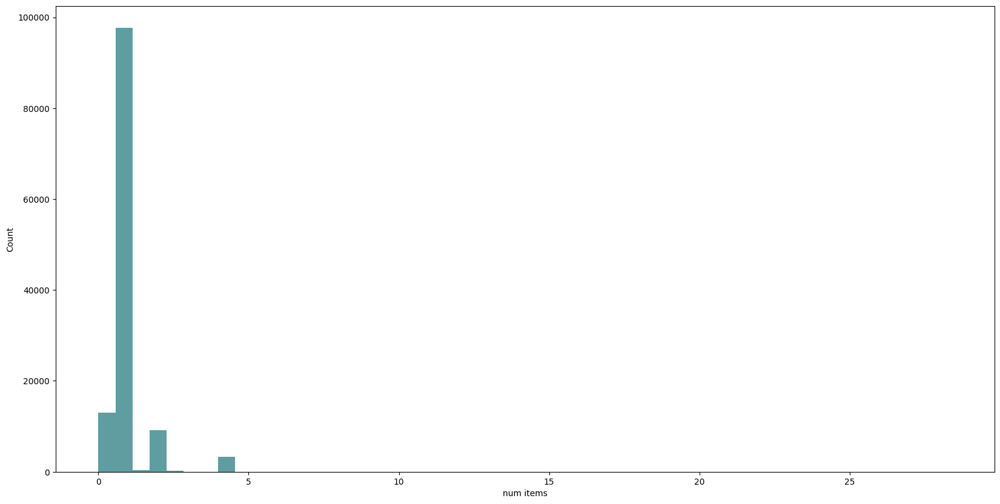

In [103]:
column = 'Credit_factor'
print('NaNs:', int(data[column].isna().sum()))
print('Dtype:', data[column].dtype)
print(data[column].value_counts(dropna=False))
fig, ax = plt.subplots()

if data[column].dtype == 'object':
    plot_histogram(ax, data, column, 'num items')
else:
    print('Max: ', data[column].max())
    print('Min: ', data[column].min())
    plot_histogram(ax, data, column, 'num items')


# Mapas

In [14]:
# Set the Mapbox access token
px.set_mapbox_access_token('pk.eyJ1IjoiYXJjYWRldGUyMSIsImEiOiJjbGY5cXlkY3oxcnp1NDBvNHNyM3MwZm9mIn0.sN_CBzeTj04J0BRjr3DJyw')

# Create a scatter mapbox plot using the customer_location DataFrame
fig = px.scatter_mapbox(data, 
                        lat = 'Latitude', 
                        lon = 'Longitude', 
                        hover_name = 'ID_Client', 
                        # color = 'customer_group',
                        color_discrete_sequence = ['cadetblue', 'silver'],
                        zoom = 1, 
                        # height = 500,
                        width = 400,
                        opacity = 0.1
                        )

# Customize the layout of the figure
fig.update_layout(mapbox_style = 'dark', 
                  margin = {'r': 0, 't': 0, 'l': 0, 'b': 0},
                  legend_title_text = 'Group', 
                  legend_title_font_color = 'black',
                  legend_orientation = 'h', 
                  legend_y = 0
                  )

# Display the figure
fig.show()

In [22]:
# Set the Mapbox access token
px.set_mapbox_access_token('pk.eyJ1IjoiYXJjYWRldGUyMSIsImEiOiJjbGY5cXlkY3oxcnp1NDBvNHNyM3MwZm9mIn0.sN_CBzeTj04J0BRjr3DJyw')

# Create a scatter mapbox plot using the customer_location DataFrame
fig = px.scatter_mapbox(data, 
                        lat = 'Longitude', 
                        lon = 'Latitude', 
                        hover_name = 'ID_Client', 
                        # color = 'customer_group',
                        color_discrete_sequence = ['cadetblue', 'silver'],
                        zoom = 1, 
                        # height = 500,
                        width = 400,
                        opacity = 0.1
                        )

# Customize the layout of the figure
fig.update_layout(mapbox_style = 'dark', 
                  margin = {'r': 0, 't': 0, 'l': 0, 'b': 0},
                  legend_title_text = 'Group', 
                  legend_title_font_color = 'black',
                  legend_orientation = 'h', 
                  legend_y = 0
                  )

# Display the figure
fig.show()

In [ ]:
# africa = data[data['Latitude'] < 30]
# europe = data[data['Latitude'] > 30]

In [15]:
# Set the Mapbox access token
px.set_mapbox_access_token('pk.eyJ1IjoiYXJjYWRldGUyMSIsImEiOiJjbGY5cXlkY3oxcnp1NDBvNHNyM3MwZm9mIn0.sN_CBzeTj04J0BRjr3DJyw')

# Create a scatter mapbox plot using the customer_location DataFrame
fig = px.scatter_mapbox(africa, 
                        lat = 'Latitude', 
                        lon = 'Longitude', 
                        hover_name = 'ID_Client', 
                        # color = 'customer_group',
                        color_discrete_sequence = ['cadetblue', 'silver'],
                        zoom = 4, 
                        # height = 500,
                        width = 400,
                        opacity = 0.1
                        )

# Customize the layout of the figure
fig.update_layout(mapbox_style = 'dark', 
                  margin = {'r': 0, 't': 0, 'l': 0, 'b': 0},
                  legend_title_text = 'Group', 
                  legend_title_font_color = 'black',
                  legend_orientation = 'h', 
                  legend_y = 0
                  )

# Display the figure
fig.show()

In [19]:
# Count the frequency of each ZIP_Code
zip_code_counts = europe['ZIP_Code'].value_counts()

# Sort the DataFrame by the frequency of ZIP_Code
europe['ZIP_Code'] = pd.Categorical(europe['ZIP_Code'], categories=zip_code_counts.index, ordered=True)
europe_sorted = europe.sort_values('ZIP_Code')

# Create a scatter mapbox plot using the sorted DataFrame
fig = px.scatter_mapbox(europe_sorted, 
                        lat='Latitude', 
                        lon='Longitude', 
                        hover_name='ID_Client', 
                        color='ZIP_Code',
                        zoom=3, 
                        width=400,
                        # opacity=0.1
                        )

# Customize the layout of the figure
fig.update_layout(mapbox_style='dark', 
                  margin={'r': 0, 't': 0, 'l': 0, 'b': 0},
                  legend_title_text='Group', 
                  legend_title_font_color='black',
                  legend_orientation='h', 
                  legend_y=0
                  )

# Display the figure
fig.show()

In [63]:
# Count the frequency of each ZIP_Code
zip_code_counts = africa['ZIP_Code'].value_counts()

# Sort the DataFrame by the frequency of ZIP_Code
africa['ZIP_Code'] = pd.Categorical(africa['ZIP_Code'], categories=zip_code_counts.index, ordered=True)
africa_sorted = africa.sort_values('ZIP_Code')

# Create a scatter mapbox plot using the sorted DataFrame
fig = px.scatter_mapbox(africa_sorted, 
                        lat='Latitude', 
                        lon='Longitude', 
                        hover_name='ID_Client', 
                        color='ZIP_Code',
                        zoom=4, 
                        width=400,
                        # opacity=0.1
                        )

# Customize the layout of the figure
fig.update_layout(mapbox_style='dark', 
                  margin={'r': 0, 't': 0, 'l': 0, 'b': 0},
                  legend_title_text='Group', 
                  legend_title_font_color='black',
                  legend_orientation='h', 
                  legend_y=0
                  )

# Display the figure
fig.show()

In [68]:
znull = data[data['ZIP_Code'].isnull()]

# Create a scatter mapbox plot using the sorted DataFrame
fig = px.scatter_mapbox(znull, 
                        lat='Latitude', 
                        lon='Longitude', 
                        hover_name='ID_Client', 
                        # color='ZIP_Code',
                        zoom=2, 
                        width=400,
                        # opacity=0.1
                        )

# Customize the layout of the figure
fig.update_layout(mapbox_style='dark', 
                  margin={'r': 0, 't': 0, 'l': 0, 'b': 0},
                  legend_title_text='Group', 
                  legend_title_font_color='black',
                  legend_orientation='h', 
                  legend_y=0
                  )

# Display the figure
fig.show()

# Correlations

In [8]:
data.columns

Index(['ID_Client', 'Frequency_items', 'Potencial_Score', 'ZIP_Code',
       'Longevity_months', 'Latitude', 'Longitude', 'Credit_factor',
       'Relevance_criteria', 'Recency_in_weeks', 'Returns', 'Flaged',
       'Promotional_percentage', 'Beer', 'Bottled_Water', 'Bread', 'Meat',
       'Dairy', 'Fresh_Foods', 'Frozen_Foods', 'Fruit_Beverages', 'Pastry',
       'Sodas', 'Toiletries', 'Veggies', 'Wines'],
      dtype='object')

In [9]:
data_num = data.drop(columns=['Relevance_criteria']) #'ID_Client', 'Latitude', 'Longitude', 'ZIP_Code', , 'Flaged', 'Potencial_Score', 'Credit_factor'

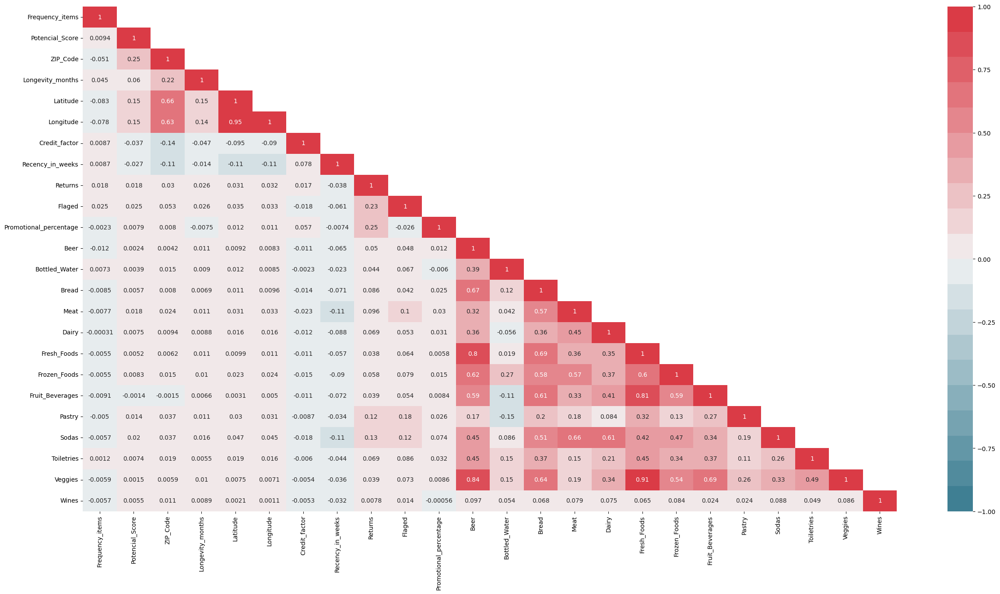

In [ ]:
plot_correlation_matrix(data_num.iloc[:, 1:], 'pearson')

# IDs

In [ ]:
pd.set_option('display.max_columns', None)
data[data['ID_Client'].duplicated(keep=False) & data['ID_Client'].notnull() & (data['ID_Client'] != ' ')].sort_values(by='ID_Client')

,ID_Client,Frequency_items,Potencial_Score,ZIP_Code,Longevity_months,Latitude,Longitude,Credit_factor,Relevance_criteria,Recency_in_weeks,Returns,Flaged,Promotional_percentage,Beer,Bottled_Water,Bread,Meat,Dairy,Fresh_Foods,Frozen_Foods,Fruit_Beverages,Pastry,Sodas,Toiletries,Veggies,Wines
44135,100072GDENKID790,14,26.38,8,27,1.250000,-2.000000,1.0,Priority,7,0,0.0,16.00,87,84,30,0,34,39,104.0,-1,38,52,4,29,38
44669,100072GDENKID790,4,27.68,8,29,-0.571429,0.666667,1.0,Priority,9,0,0.0,16.00,85,86,30,0,34,39,105.0,-1,38,27,11,34,38
40991,10011581SAN10NKID313,43,37.16,8,25,57.726877,19.332201,0.7,Priority,6,0,0.0,0.00,51,47,31,0,35,134,42.0,97,36,4,14,19,16
2582,10011581SAN10NKID313,45,35.36,8,20,59.679258,17.165534,0.7,Priority,13,0,0.0,0.00,51,47,31,0,92,62,42.0,18,121,2,14,17,61
122504,10025167ORG1NKID411,44,80.27,8,17,59.053913,15.240168,0.7,Priority,10,0,0.0,36.00,41,44,29,0,19,127,48.0,103,43,60,15,21,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18591,9968077STE13NKID371,33,38.15,8,-3,62.896545,10.827141,0.7,Priority,14,0,0.0,0.00,43,35,18,0,83,41,20.0,13,28,16,23,12,23
33220,9968081STA8NKID591,33,79.56,8,-1,60.853229,21.398923,0.7,Priority,12,192,0.0,0.00,41,45,31,0,75,3,13.0,10,110,60,7,-20,42
29480,9968081STA8NKID591,28,80.56,8,10,56.853229,25.565590,0.7,Priority,10,192,0.0,0.00,41,45,17,0,79,3,13.0,10,30,0,17,-11,-7
8415,9971048feG12NKID494,18,0.90,0,8,0.000000,-0.500000,1.0,Priority,13,0,0.0,14.29,44,39,30,1,86,15,33.0,7,109,21,17,3,47


In [10]:
# Define the regex pattern to extract the sequences
pattern = r'(\d+)([A-Za-z]+)(\d+)([A-Za-z]+)(\d+)'

# Create a new dataframe with the extracted sequences
data_id = data.copy()
data_id[['Num0', 'Seq1', 'Num1', 'Seq2', 'Num2']] = data['ID_Client'].str.extract(pattern)

# Display the first few rows to verify the result
data_id.head()

,ID_Client,Frequency_items,Potencial_Score,ZIP_Code,Longevity_months,Latitude,Longitude,Credit_factor,Relevance_criteria,Recency_in_weeks,...,Pastry,Sodas,Toiletries,Veggies,Wines,Num0,Seq1,Num1,Seq2,Num2
0,10156431SEG17NKID781,38,-0.40,0,23,0.000000,-1.666667,0.7,Priority,11,...,27,24,27,10,0,10156431,SEG,17,NKID,781
1,9056576FIA11NKID679,50,-0.30,0,24,0.200000,0.000000,0.7,Priority,6,...,31,-12,2,18,2,9056576,FIA,11,NKID,679
2,9253304IST6NKID248,48,1.60,0,32,0.428571,1.000000,0.7,Priority,16,...,32,17,33,26,-13,9253304,IST,6,NKID,248
3,9661067PER12NKID393,46,-0.90,0,-4,-0.400000,-0.500000,4.5,Priority,10,...,29,31,28,-2,8,9661067,PER,12,NKID,393
4,9956825FEG11NKID326,31,31.61,8,10,1.000000,0.714286,0.7,Priority,8,...,45,46,19,23,9,9956825,FEG,11,NKID,326


In [11]:
data_id['is_africa'] = data.index.isin(africa.index).astype(int)

In [12]:
data_id['Seq2'].unique()

array(['NKID', nan, 'G', 'R', 'C'], dtype=object)

In [13]:
data_id['Num1'].unique()

array(['17', '11', '6', '12', '8', '2', '4', '9', '10', '14', nan, '7',
       '13', '5', '3', '20', '15', '16', '1', '0', '18', '21', '112',
       '19', '29', '215', '714', '110', '311', '2911', '26', '212', '611',
       '39', '412', '213', '718', '177', '115', '22', '34', '78', '85',
       '27', '712', '297', '48', '42', '815', '63', '1714', '207'],
      dtype=object)

In [14]:
data_id['Num2'].unique()

array(['781', '679', '248', '393', '326', '237', '550', '774', '827',
       '433', '402', '744', '501', '389', '607', '484', '382', '467',
       '369', '800', '516', '290', '370', nan, '802', '777', '515', '815',
       '670', '401', '351', '493', '708', '613', '267', '337', '647',
       '434', '776', '603', '547', '510', '789', '614', '732', '531',
       '658', '617', '756', '244', '830', '641', '350', '399', '437',
       '418', '446', '444', '666', '600', '737', '445', '639', '475',
       '790', '581', '463', '537', '340', '319', '792', '853', '263',
       '287', '848', '629', '452', '717', '323', '705', '727', '300',
       '742', '791', '586', '707', '339', '700', '333', '799', '605',
       '676', '307', '583', '785', '259', '331', '335', '599', '354',
       '385', '591', '427', '527', '348', '697', '778', '849', '575',
       '818', '256', '684', '460', '719', '521', '864', '343', '726',
       '442', '234', '406', '359', '765', '367', '432', '678', '615',
       '477', '

Wines	Potencial_Score	Veggies	Sodas	Longevity_months	Toiletries	Returns	Promotional_percentage	Fruit_Beverages	Fresh_Foods	Frozen_Foods	Recency_in_weeks	Meat	Bread

In [15]:
data_wo_o = data.drop(data[data['Beer'] > 5000].index)

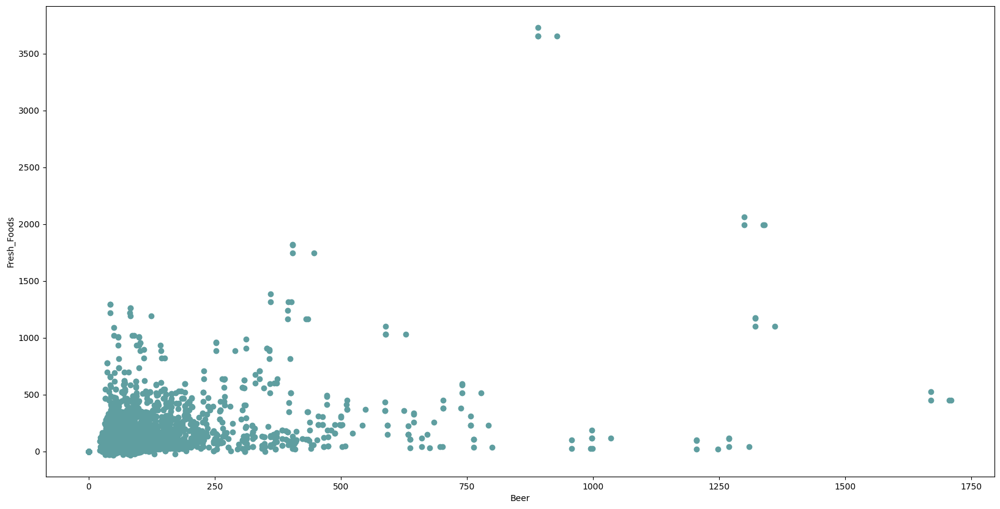

In [17]:
plot_scatter(plt.subplots()[1], data_wo_o, 'Beer', 'Fresh_Foods')

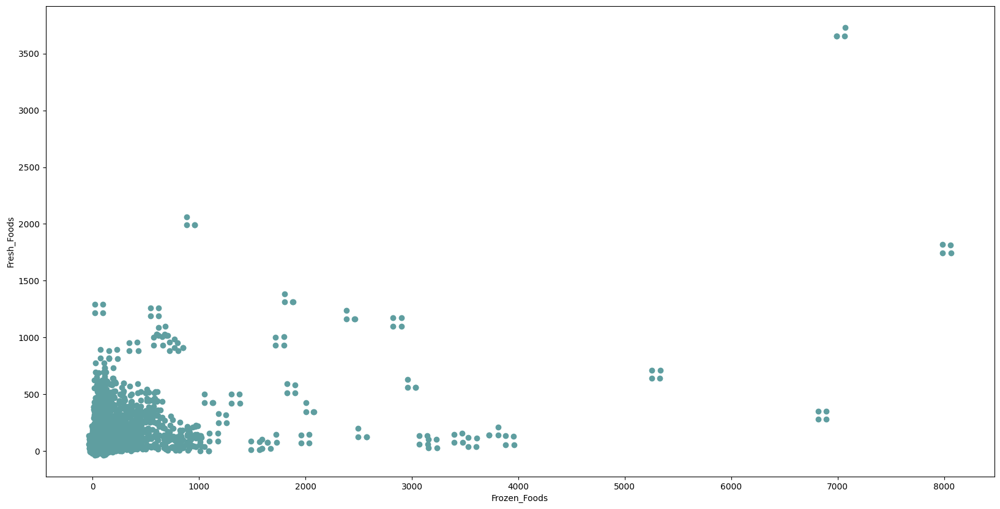

In [18]:
plot_scatter(plt.subplots()[1], data_wo_o, 'Frozen_Foods', 'Fresh_Foods')

# Null Rows

In [21]:
# Calculate the percentage of null values for each row
data['null_percentage'] = data.isnull().mean(axis=1) * 100

# Display the first few rows to verify the result
null_percentages = data[['ID_Client', 'null_percentage']]

In [23]:
null_percentages_bt0 = null_percentages[null_percentages['null_percentage'] > 0].sort_values('null_percentage', ascending=False)

In [ ]:
null_percentages_bt0['null_percentage'].value_counts() # O maximo que temos é rows com 2 missing values (4470 têm 1; 59 têm 2)

null_percentage
3.703704    4470
7.407407      59
Name: count, dtype: int64